# Implementation of the article - StyleGAN-NADA: CLIP-Guided Domain Adaptation of Image Generators. Train notebook

Метод StyleGAN-NADA использует CLIP для выравнивания исходных и целевых доменов в пространстве CLIP. Он оптимизирует синтезирующую сеть целевого домена с использованием функции потерь направления между изображениями и текстовыми описаниями.

В этом ноутбуке реализованы основные функции: выбор k-top слоев доя разморозки и обучение модели.

In [1]:
# Установка необходимых библиотек
import os
os.environ['TORCH_CUDA_ARCH_LIST'] = '7.5'

# Установка зависимостей
!pip install ftfy regex tqdm Ninja

# клонирование репозитория StyleCLIP, чтобы использовать его методы
!pip install git+https://github.com/openai/CLIP.git

# Импорт нужных библиотек
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import clip
import numpy as np
import matplotlib.pyplot as plt
import re


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.8/422.8 kB 15.3 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-9g5jhf_l
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-9g5jhf_l
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 85.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 69.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 47.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
# Будем работать с конкретным сидом
torch.manual_seed(345)

In [3]:
# Clone StyleGAN2 model from rosinality repository

# official stylegan2-pytorch
!git clone https://github.com/rosinality/stylegan2-pytorch.git

# загрузка адаптированного OneshotCLIP чекпоинта stylegan2-ffhq One-Shot Adaptation of GAN in Just One CLIP (в формате pytorch)
!wget https://huggingface.co/akhaliq/OneshotCLIP-stylegan2-ffhq/resolve/main/stylegan2-ffhq-config-f.pt -O stylegan2-ffhq-config-f.pt

%cd stylegan2-pytorch

Cloning into 'stylegan2-pytorch'...
remote: Enumerating objects: 395, done.
remote: Total 395 (delta 0), reused 0 (delta 0), pack-reused 395 (from 1)
Receiving objects: 100% (395/395), 122.51 MiB | 19.55 MiB/s, done.
Resolving deltas: 100% (205/205), done.
--2025-07-13 11:47:59--  https://huggingface.co/akhaliq/OneshotCLIP-stylegan2-ffhq/resolve/main/stylegan2-ffhq-config-f.pt
Resolving huggingface.co (huggingface.co)... 3.163.189.74, 3.163.189.37, 3.163.189.90, ...
Connecting to huggingface.co (huggingface.co)|3.163.189.74|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs.hf.co/repos/e9/a3/e9a3ec3ca794fe184757f39017bb3836044f5de0c2ff76d7109137c040c4b817/bae494ef77e32a9cd1792a81a3c167692a0e64f6bcd8b06592ff42917e2ed46e?response-content-disposition=inline%3B+filename*%3DUTF-8%27%27stylegan2-ffhq-config-f.pt%3B+filename%3D%22stylegan2-ffhq-config-f.pt%22%3B&Expires=1752410879&Policy=eyJTdGF0ZW1lbnQiOlt7IkNvbmRpdGlvbiI6eyJEYXRlTGVzc1RoYW4iOnsiQV

In [4]:
# StyleGAN2 model and additional modules import

import torch.nn.functional as F
from tqdm import tqdm
from model import Generator
# import argparse
# from IPython.display import display

## Key Params

In [5]:
# Key params

stylegan2_checkpoint_path = "/content/stylegan2-ffhq-config-f.pt"
prompt_orig = "face"
prompt_target = "Pixar cartoon" # "Shrek"
image_size = 1024
latent_dim = 512
steps = 300 # рекомендации
batch_size = 2
lr = 0.002 # рекомендации
alpha = 0.5
outdir = "content/output_checkpoints"
unfreeze_layers = 10 # (0 = все слои, -1 = автоматический выбор)
device = "cuda" if torch.cuda.is_available() else "cpu"

In [6]:
os.makedirs(outdir, exist_ok=True)

In [7]:
# CLIP model loading
clip_model, _ = clip.load("ViT-B/32", device=device)
clip_model.eval().requires_grad_(False)

100%|████████████████████████████████████████| 338M/338M [00:01<00:00, 207MiB/s]


CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          

## Syle GAN 2 model loading

In [8]:
# StyleGAN2 model loading

generator = Generator(
    size=image_size,
    style_dim=latent_dim,
    n_mlp=8,
    channel_multiplier=2
).to(device)

stylegan2_checkpoint = torch.load(stylegan2_checkpoint_path, map_location=device)
generator.load_state_dict(stylegan2_checkpoint["g_ema"], strict=False)
generator.train()


Generator(
  (style): Sequential(
    (0): PixelNorm()
    (1): EqualLinear(512, 512)
    (2): EqualLinear(512, 512)
    (3): EqualLinear(512, 512)
    (4): EqualLinear(512, 512)
    (5): EqualLinear(512, 512)
    (6): EqualLinear(512, 512)
    (7): EqualLinear(512, 512)
    (8): EqualLinear(512, 512)
  )
  (input): ConstantInput()
  (conv1): StyledConv(
    (conv): ModulatedConv2d(512, 512, 3, upsample=False, downsample=False)
    (noise): NoiseInjection()
    (activate): FusedLeakyReLU()
  )
  (to_rgb1): ToRGB(
    (conv): ModulatedConv2d(512, 3, 1, upsample=False, downsample=False)
  )
  (convs): ModuleList(
    (0): StyledConv(
      (conv): ModulatedConv2d(512, 512, 3, upsample=True, downsample=False)
      (noise): NoiseInjection()
      (activate): FusedLeakyReLU()
    )
    (1): StyledConv(
      (conv): ModulatedConv2d(512, 512, 3, upsample=False, downsample=False)
      (noise): NoiseInjection()
      (activate): FusedLeakyReLU()
    )
    (2): StyledConv(
      (conv): Modul

## Tools

In [9]:
# подключаем библиотеку с своими дополнительными функциями
!wget https://raw.githubusercontent.com/vital83/Reimplementation_of_StyleGAN-NADA/main/tools.py -O /content/stylegan2-pytorch/tools.py
import tools
from tools import *
# Text tools

with torch.no_grad():
    text_orig_emb = clip_model.encode_text(clip.tokenize(prompt_orig).to(device))
    text_target_emb = clip_model.encode_text(clip.tokenize(prompt_target).to(device))

text_orig_emb = text_orig_emb / text_orig_emb.norm(dim=-1, keepdim=True)
text_target_emb = text_target_emb / text_target_emb.norm(dim=-1, keepdim=True)


def get_text_features(source_text, target_text):
    """Получение текстовых эмбеддингов для исходного и целевого доменов"""
    text_inputs = clip.tokenize([source_text, target_text]).to(device)
    with torch.no_grad():
        text_features = clip_model.encode_text(text_inputs)
        text_features /= text_features.norm(dim=-1, keepdim=True)
    return text_features

# Conv layers plot tools
def plot_layer_importance(layer_grad_norms):
    names = list(layer_grad_norms.keys())
    values = list(layer_grad_norms.values())

    plt.figure(figsize=(12, 8))
    plt.barh(names, values)
    plt.xlabel('Gradient Norm')
    plt.title('Layer Importance for Domain Adaptation')
    plt.tight_layout()
    plt.show()

# Images output tools

def print_image_orig_target(step, num_steps, losses, img_gen, img_target):
    # Предобработка
    img_gen = (img_gen.clamp(-1,1) + 1)/2
    img_gen = (img_gen * 255).permute(1,2,0).numpy().astype(np.uint8)

    img_target = (img_target.clamp(-1,1) + 1)/2
    img_target = (img_target * 255).permute(1,2,0).numpy().astype(np.uint8)

    # Визуализация и вывод потерь
    print(f"inversion_generated_z/Step [{step}/{num_steps}], Loss: {losses['all'][-1]}")  # Вывод текущих потерь
    fig, axs = plt.subplots(1, 2, figsize=(16, 32))  # Создание подграфиков для визуализации

    # Визуализация сгенерированного изображения
    # axs[0].imshow((img_gen.cpu().detach()[0].clip(-1,1).permute(1, 2, 0) + 1) / 2)
    axs[0].imshow(img_gen)
    axs[0].set_title("Сгенерированное изображение")  # Заголовок для сгенерированного изображения
    axs[0].axis('off')  # Отключение осей

    # Визуализация целевого изображения
    # axs[1].imshow((img_target.cpu().detach()[0].clip(-1,1).permute(1, 2, 0) + 1) / 2)
    axs[1].imshow(img_target)
    axs[1].set_title("Целевое изображение")  # Заголовок для целевого изображения
    axs[1].axis('off')  # Отключение осей
    plt.show()

--2025-07-13 11:49:48--  https://raw.githubusercontent.com/vital83/Reimplementation_of_StyleGAN-NADA/main/tools.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4714 (4.6K) [text/plain]
Saving to: ‘/content/stylegan2-pytorch/tools.py’

/content/stylegan2- 100%[===================>]   4.60K  --.-KB/s    in 0s      

2025-07-13 11:49:48 (60.0 MB/s) - ‘/content/stylegan2-pytorch/tools.py’ saved [4714/4714]



## Key function - select and  unfreeze top-k layers

In [10]:

# Step_1: итерация оптимизации latent_code, используя Global Clip Loss - рекомендации 1 итерация
# - ищем k-слоев, у которых latent_code изменился максимально - рекомендации по k для ffhq см. ниже
# - размораживаем эти выбранные по изменению градиента k-слоев

def select_layers_to_unfreeze(generator, latent_dim, truncation, mean_latent, text_features, unfreeze_layers, num_samples=1):
        """
        Алгоритм выбора слоев для разморозки

        Шаги:
        1. Размораживаем все слои
        2. Для каждого слоя вычисляем градиент CLIP-лосса
        3. Выбираем top-k слоев с наибольшей нормой градиента
        4. Замораживаем все кроме top-k

        :param unfreeze_layers: Количество слоев для разморозки (0 = все слои, -1 = автоматический выбор)

        """

        # Временно размораживаем ВСЕ параметры чтобы можно было работать градиентами
        generator = unfreeze_all_layers(generator)


        # Собираем все обучаемые слои
        layers = get_all_conv_and_to_rgb_layers(generator)
        layer_grad_norms = {name: 0 for name, _ in layers}

        if unfreeze_layers == -1:
            print("Автоматический выбор слоев для разморозки...")
            total_layers = len(layers)
            unfreeze_layers = max(5, total_layers // 2)

        # Временный оптимизатор
        optimizer = torch.optim.SGD(generator.parameters(), lr=0.1)

        # Итерации
        for _ in range(num_samples):
            # Генерация случайного латентного вектора
            z = torch.randn(1, latent_dim).to(device)

            # Прямой проход
            optimizer.zero_grad()
            w = generator.get_latent(z)
            img, _ = generator(
                [w],
                truncation=truncation,
                truncation_latent=mean_latent
            )

            # CLIP-лосс
            processed_img = clip_preprocess_tensor(img)
            img_features = clip_model.encode_image(processed_img)
            loss = directional_loss(img_features, text_features)

            # Обратное распространение
            loss.backward()

            # Сбор норм градиентов
            for name, module in layers:
                if module.weight.grad is not None:
                    grad_norm = torch.norm(module.weight.grad).item()
                    layer_grad_norms[name] += grad_norm

        # Усредняем по образцам
        for name in layer_grad_norms:
            layer_grad_norms[name] /= num_samples

        # Выбираем top-k слоев с наибольшими градиентами
        sorted_layers = sorted(layer_grad_norms.items(), key=lambda x: x[1], reverse=True)
        top_layers = [name for name, norm in sorted_layers[:unfreeze_layers]]

        print(f"Выбрано слоев для разморозки: {unfreeze_layers}")
        for i, (name, norm) in enumerate(sorted_layers[:unfreeze_layers]):
            print(f"{i+1}. {name}: {norm:.6f}")

        # Все слои модели уже разморожены выше чтобы можно было работать с градиентами
        # замораживаем только те convs, которые не попали в top-k слоев
        generator = freeze_all_convs_except(generator, top_layers)


        return generator, layer_grad_norms, top_layers


## Select k-top layers to unfreeze

/content/stylegan2-pytorch/op/conv2d_gradfix.py:88: UserWarning: conv2d_gradfix not supported on PyTorch 2.6.0+cu124. Falling back to torch.nn.functional.conv2d().
  warnings.warn(


Выбрано слоев для разморозки: 10
1. 7.conv: 0.071788
2. 3.conv: 0.068232
3. 2.conv: 0.059928
4. 6.conv: 0.057663
5. 4.conv: 0.042494
6. 1.conv: 0.039232
7. 5.conv: 0.038407
8. 0.conv: 0.018606
9. 11.conv: 0.011170
10. 9.conv: 0.010196


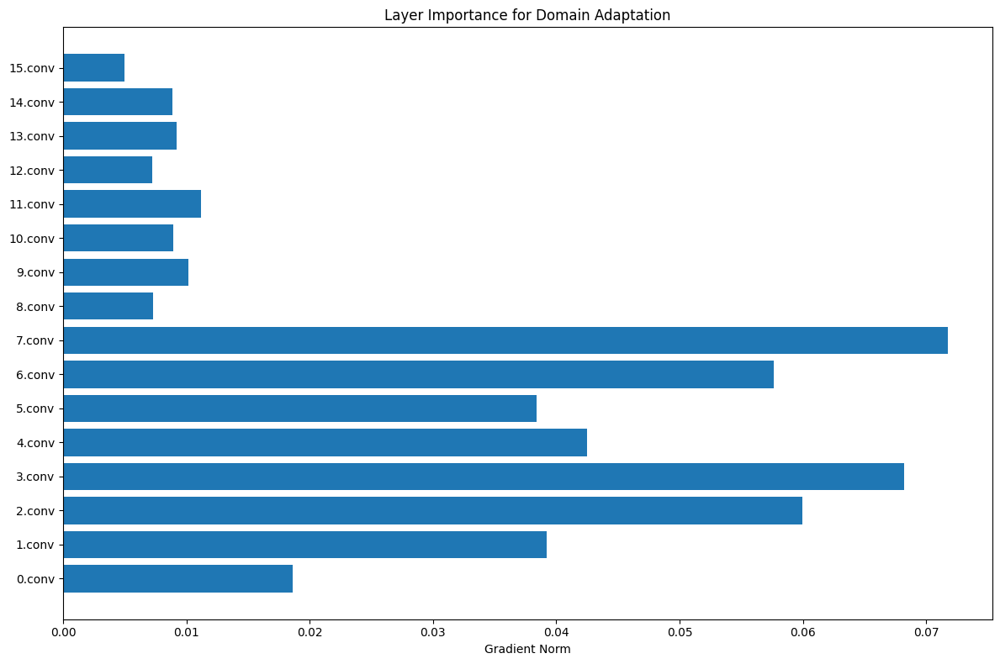

In [11]:
# Запуск подбора k-top слоев для разморозки

truncation=1 # truncation=0.7
truncation_mean=4096
mean_latent = generator.mean_latent(truncation_mean)
text_features = get_text_features(prompt_orig, prompt_target)

generator, layer_grad_norms, top_layers = select_layers_to_unfreeze(generator, latent_dim, truncation, mean_latent, text_features, unfreeze_layers)
plot_layer_importance(layer_grad_norms)

## Training model and image output every 50 steps

Training:   0%|          | 0/300 [00:00<?, ?it/s, loss=-0.0585]

inversion_generated_z/Step [0/300], Loss: -0.0584716796875


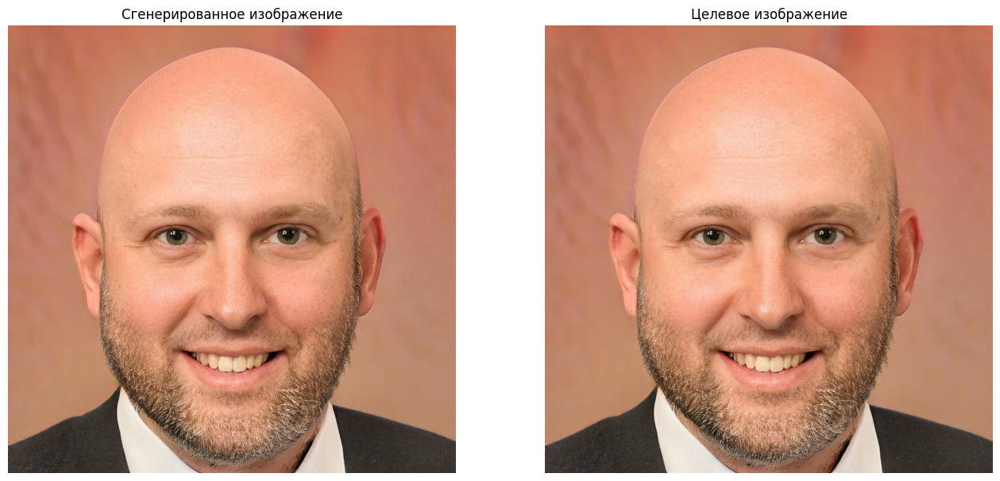

inversion_generated_z/Step [0/300], Loss: -0.0584716796875


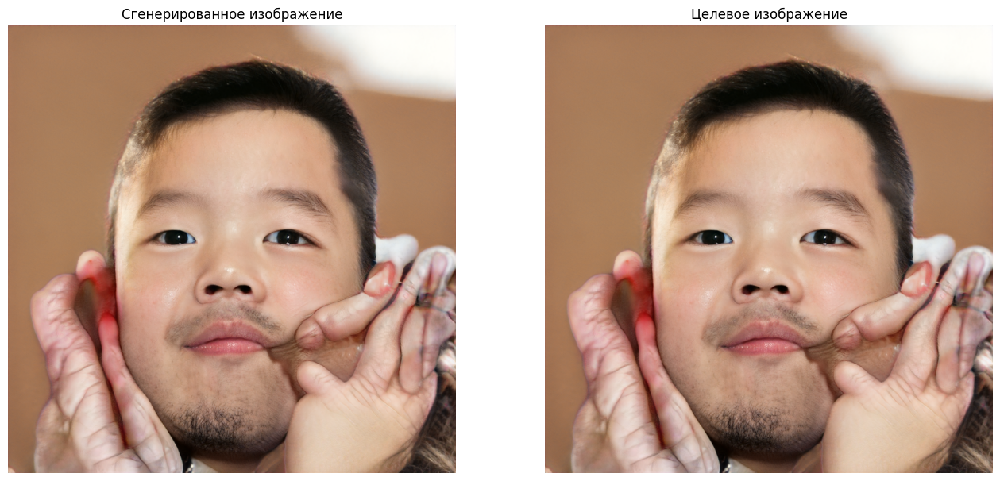

Training:  17%|█▋        | 50/300 [00:19<01:28,  2.82it/s, loss=-0.1924]

inversion_generated_z/Step [50/300], Loss: -0.1923828125


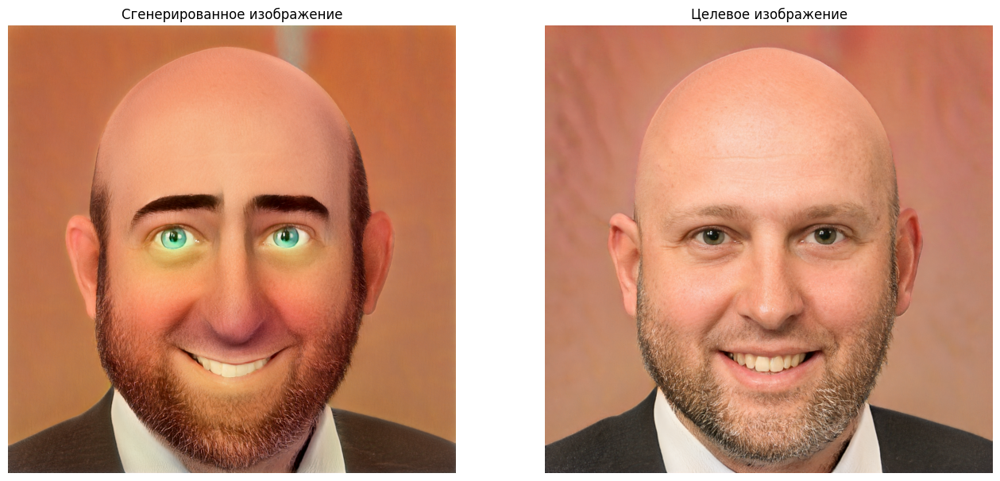

inversion_generated_z/Step [50/300], Loss: -0.1923828125


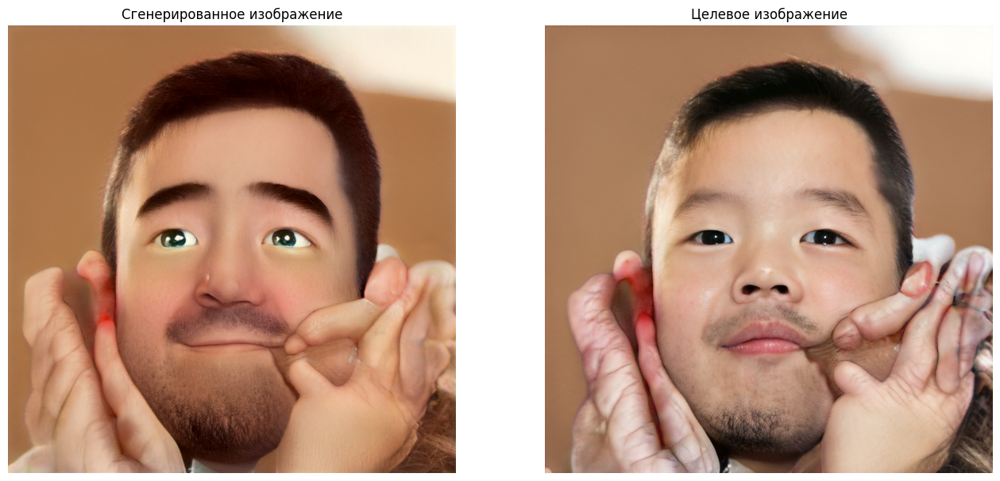

Training:  33%|███▎      | 100/300 [00:39<01:11,  2.79it/s, loss=-0.2134]

inversion_generated_z/Step [100/300], Loss: -0.21337890625


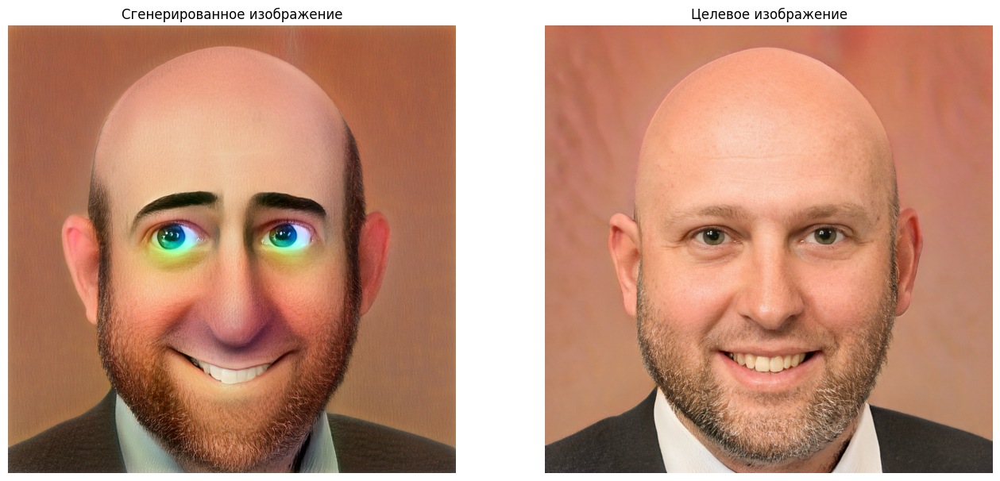

inversion_generated_z/Step [100/300], Loss: -0.21337890625


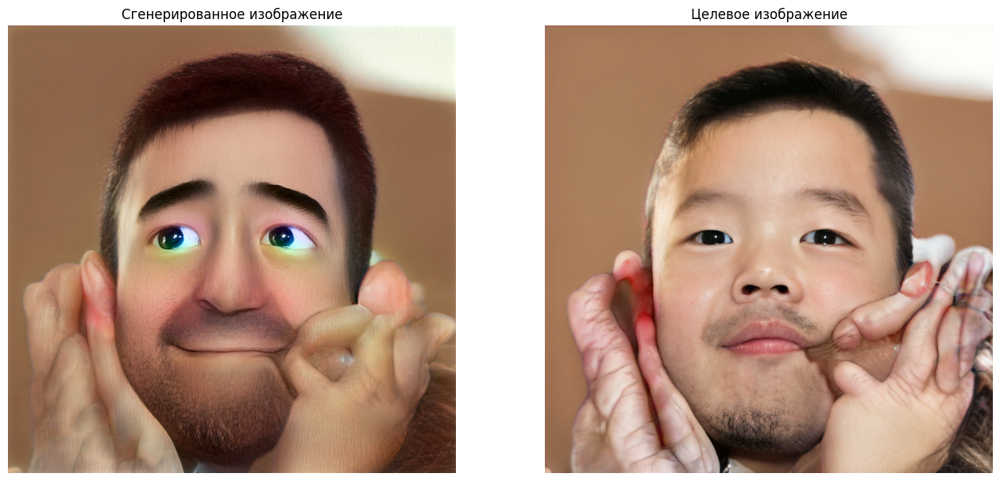

Training:  50%|█████     | 150/300 [00:59<00:56,  2.66it/s, loss=-0.2290]

inversion_generated_z/Step [150/300], Loss: -0.22900390625


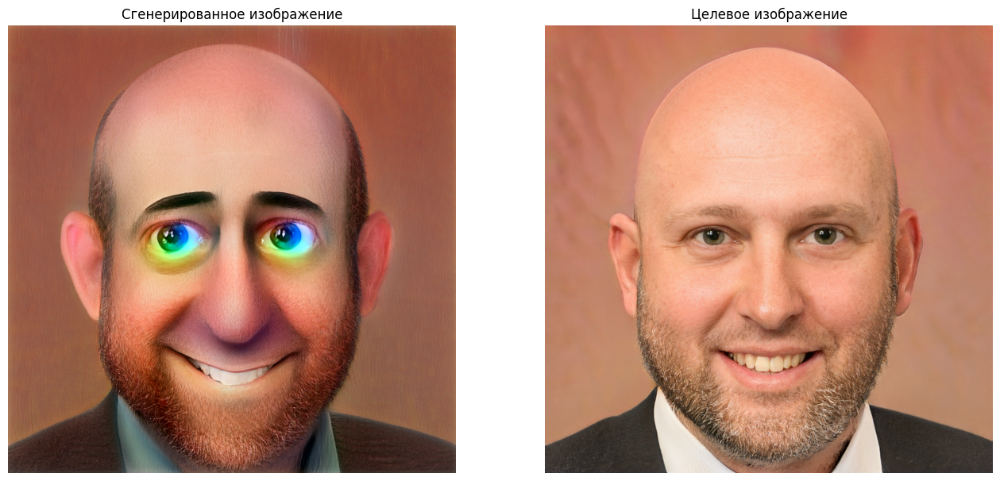

inversion_generated_z/Step [150/300], Loss: -0.22900390625


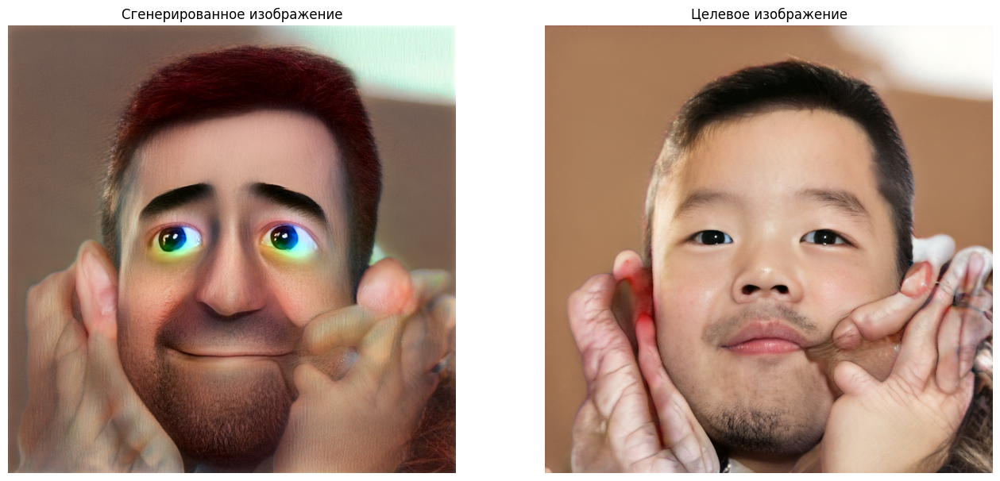

Training:  67%|██████▋   | 200/300 [01:19<00:38,  2.59it/s, loss=-0.2300]

inversion_generated_z/Step [200/300], Loss: -0.22998046875


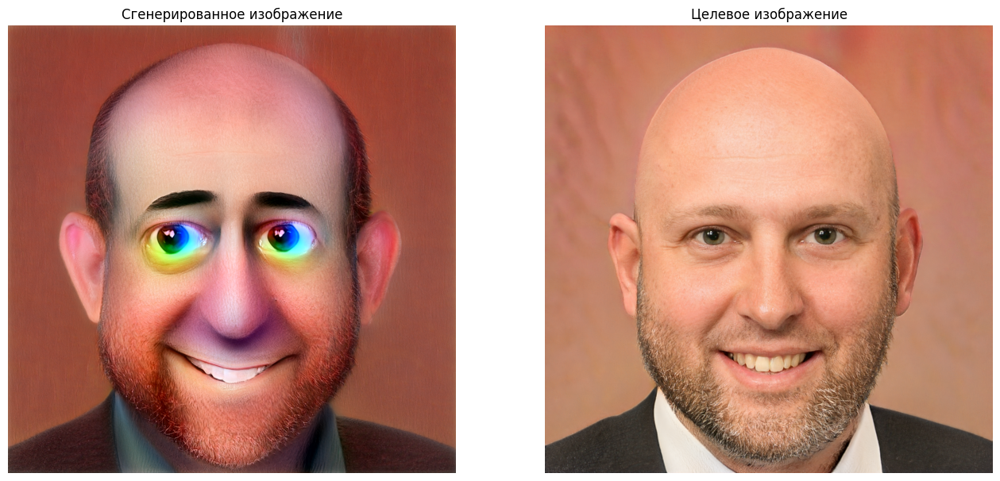

inversion_generated_z/Step [200/300], Loss: -0.22998046875


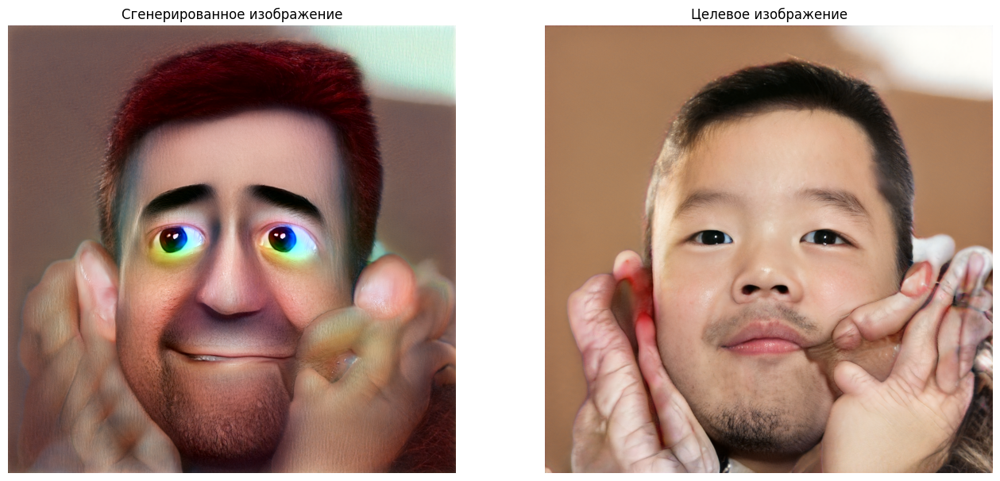

Training:  83%|████████▎ | 250/300 [01:41<00:20,  2.49it/s, loss=-0.2546]

inversion_generated_z/Step [250/300], Loss: -0.254638671875


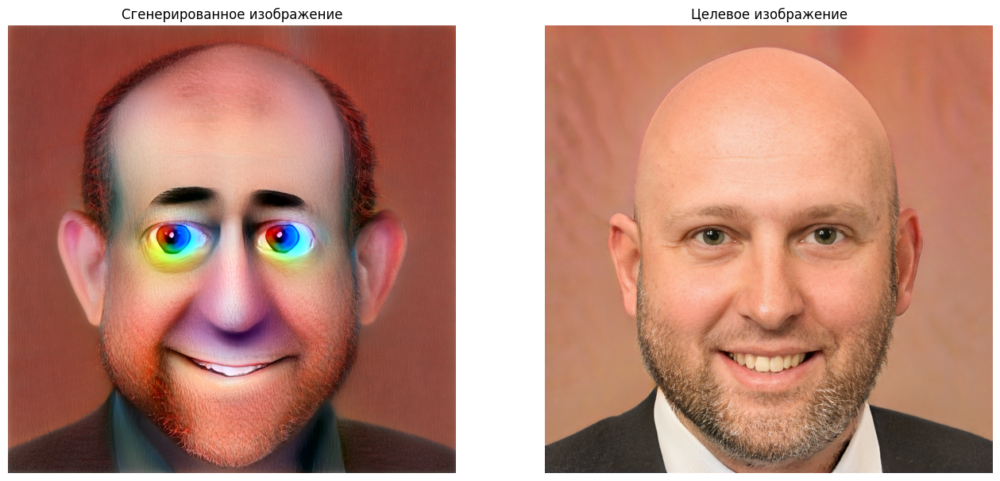

inversion_generated_z/Step [250/300], Loss: -0.254638671875


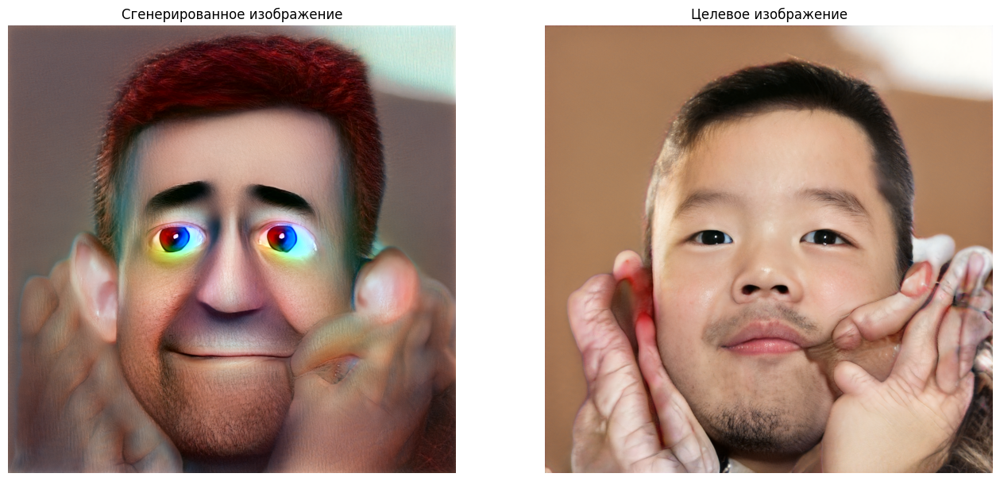

Training: 100%|█████████▉| 299/300 [02:03<00:00,  2.40it/s, loss=-0.2544]

inversion_generated_z/Step [299/300], Loss: -0.25439453125


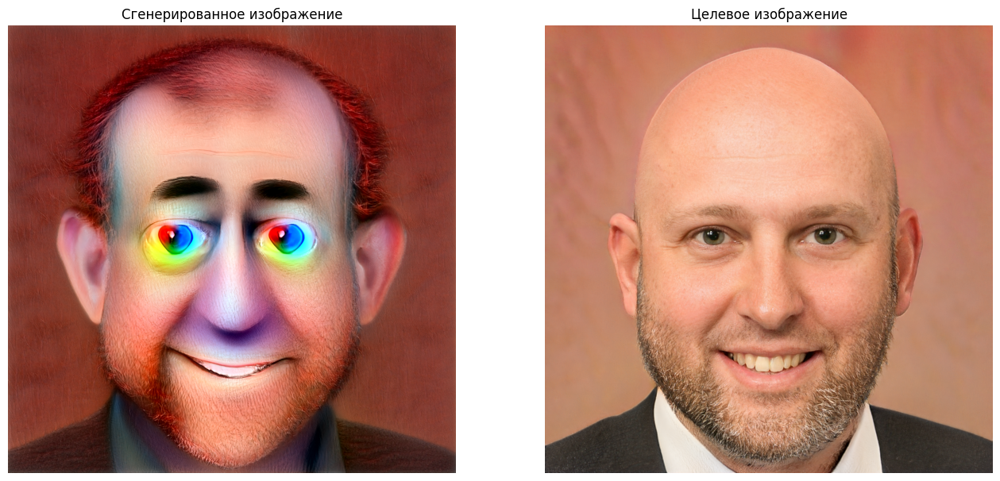

inversion_generated_z/Step [299/300], Loss: -0.25439453125


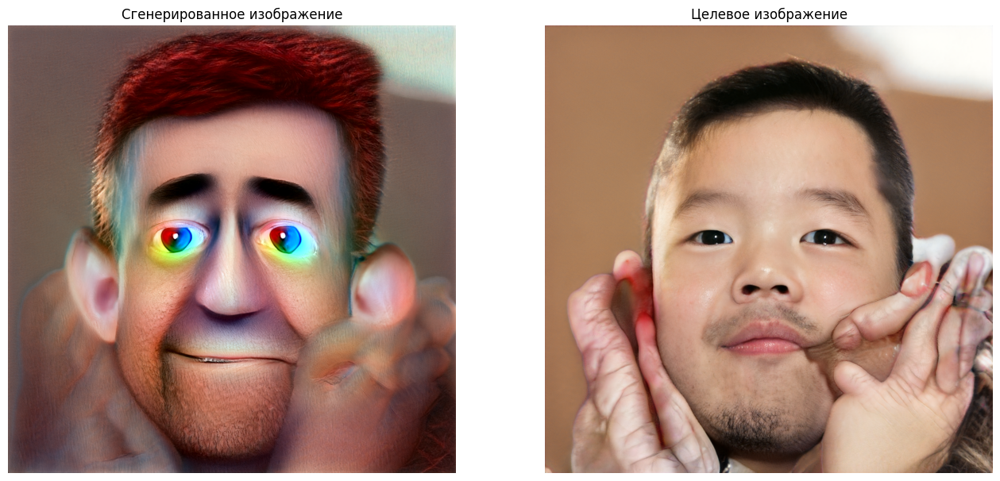

Training: 100%|██████████| 300/300 [02:05<00:00,  2.40it/s, loss=-0.2544]


In [12]:
# Обучение модели и вывод результатов
LATENT_COUNT = 2 # сколько будем генерировать векторов

# Adam-optimizer
params_to_optimize = [p for p in generator.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params_to_optimize, lr=lr, betas=(0.0, 0.99))

fixed_z = torch.randn(LATENT_COUNT, latent_dim, device=device)
pbar = tqdm(range(steps), desc="Training")

losses = {# 'clip': []
          'all': []
          }

for step_i in pbar:
    optimizer.zero_grad()

    z = torch.randn(batch_size, latent_dim, device=device)
    generated_imgs, _ = generator([z], truncation=1, input_is_latent=False)


    clip_in = clip_preprocess_tensor(generated_imgs)
    image_embeds = clip_model.encode_image(clip_in)
    image_embeds = image_embeds / image_embeds.norm(dim=-1, keepdim=True)

    target_sim = (image_embeds * text_target_emb).sum(dim=-1)
    orig_sim   = (image_embeds * text_orig_emb).sum(dim=-1)

    clip_loss = - (target_sim - alpha * orig_sim).mean()
    clip_loss.backward()
    optimizer.step()

    clip_loss_val = clip_loss.item()
    # losses['clip'].append(clip_loss_val)
    losses['all'].append(clip_loss_val)
    pbar.set_postfix({"loss": f"{clip_loss_val:.4f}"})

    # вывод результатов каждые шагов и на последнем шаге
    if step_i % 50 == 0 or step_i == steps - 1:
        with torch.no_grad():
            fixed_imgs, _ = generator([fixed_z], truncation=1, input_is_latent=False)
            if step_i == 0:
                target_imgs = fixed_imgs.clone()

        for idx in range(LATENT_COUNT):
            print_image_orig_target(step_i, steps, losses, fixed_imgs[idx].detach().cpu(), target_imgs[idx].detach().cpu())


## Save checkpoint

In [13]:
# Save model checkpoint

final_stylegan2_checkpoint_path = os.path.join(outdir, "stylegan2_nada_final.pt")
torch.save({"g_ema": generator.state_dict()}, final_stylegan2_checkpoint_path)
print("Done! Final checkpoint saved to:", final_stylegan2_checkpoint_path)

Done! Final checkpoint saved to: content/output_checkpoints/stylegan2_nada_final.pt


## Load checkpoint and show inference

inversion_generated_z/Step [1/1], Loss: -0.25439453125


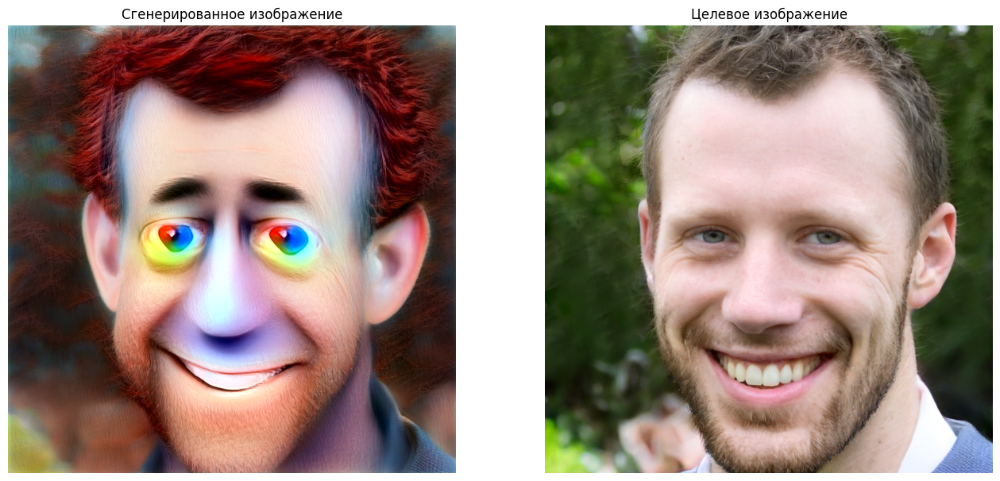

inversion_generated_z/Step [1/1], Loss: -0.25439453125


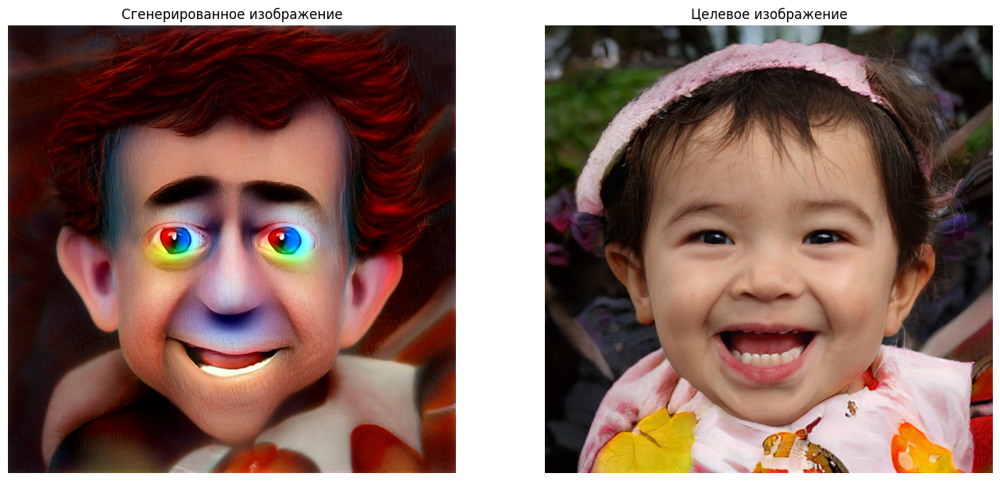

In [14]:
# Проверка генерации StyleGAN2-NADA
# Выводим LATENT_СOUNT изображений на основе LATENT_СOUNT случайных векторов

stylegan2_final_checkpoint_path = "content/output_checkpoints/stylegan2_nada_final.pt"
checkpoint = torch.load(stylegan2_final_checkpoint_path, map_location=device)
generator.load_state_dict(checkpoint["g_ema"])
generator.eval()

# загружаем веса исходного генератора
generator_unmodified = Generator(
    size=image_size,
    style_dim=latent_dim,
    n_mlp=8,
    channel_multiplier=2
).to(device)

checkpoint_unmodified = torch.load(stylegan2_checkpoint_path, map_location=device)
generator_unmodified.load_state_dict(checkpoint_unmodified["g_ema"])
generator_unmodified.eval()

z = torch.randn(LATENT_COUNT, latent_dim, device=device)

with torch.no_grad():
    for i in range(LATENT_COUNT):

        target_imgs, _ = generator_unmodified([z], truncation=1, input_is_latent=False)
        fixed_imgs, _ = generator([z], truncation=1, input_is_latent=False)

        print_image_orig_target(1, 1, losses, fixed_imgs[i].cpu(), target_imgs[i].detach().cpu())
